Water Quality Data Time Series from the [Florida St Johns River Water Management District (SJRWMD)](https://www.sjrwmd.com/data/water-quality/)

Standard Physical and Chemical In-Situ Oceanic/Water Quality Variables of the Indian River Lagoon, Merritt Island, NASA Kennedy Space Center, Florida are collected and hosted by the **[SJRWMD page](http://webapub.sjrwmd.com/agws10/hdswq/)**. I do have access to the FTP but it is single user/password enabled so the map page is the primary method of downloading data. Data is formated by variable, by individual sensor, collected every hour, and aggregated into **.CSV** files. 

Data used here are stored in "data" folder (~17mb) in this directory. Refer to ["SampleMap.png"](SampleMap.png) for details on downloading this data yourself. 

This notebook should import and read the **.CSV** file for Water Temperature, Conductivity, and Chlorophyll.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import hvplot.pandas

## Read in data from .csv files

In [85]:
sst = pd.read_csv('data/water_temp.csv', skiprows=9,
                  names=['Date/Time', 'Parameter', 'Water Temp (°C)', 'Units', 'Station ID', 'Comments'],
                  index_col=0, 
                  usecols = [0, 2],
                  parse_dates=True, infer_datetime_format=True)
cdt = pd.read_csv('data/conductivity.csv', skiprows=9, 
                  names=['Date/Time', 'Parameter', 'Conductivity (uS/cm)', 'Units', 'Station ID', 'Comments'],
                  index_col=0, 
                  usecols = [0, 2],
                  parse_dates=True, infer_datetime_format=True)
chl = pd.read_csv('data/rel_chlor.csv', skiprows=9, 
                  names=['Date/Time', 'Parameter', 'Rel. Chlorophyl (RFU)', 'Units', 'Station ID', 'Comments'],
                  index_col=0, 
                  usecols = [0, 2],
                  parse_dates=True, infer_datetime_format=True)

## Merge into one df with common index

In [137]:
wq_data = pd.concat([sst, cdt, chl])  # merge all datasets into 1 df with common index
wq_data = wq_data[:-1]                # drop NaN row at the end

wq_data.iloc[:,1] = wq_data.iloc[:,1]/1000    # convert uS/cm -> mS/cm
wq_data.rename(columns={'Conductivity (uS/cm)': 'Conductivity (mS/cm)'}, inplace=True)  #replace units in column header

wq_data

,Water Temp (°C),Conductivity (mS/cm),Rel. Chlorophyl (RFU)
Date/Time,,,
2014-05-14 14:00:00,28.02,NaN,NaN
2014-05-14 15:00:00,28.10,NaN,NaN
2014-05-14 16:00:00,28.20,NaN,NaN
2014-05-14 17:00:00,28.14,NaN,NaN
2014-05-14 18:00:00,28.08,NaN,NaN
...,...,...,...
2020-09-27 18:00:00,NaN,NaN,9.42
2020-09-27 19:00:00,NaN,NaN,9.19
2020-09-27 20:00:00,NaN,NaN,9.93


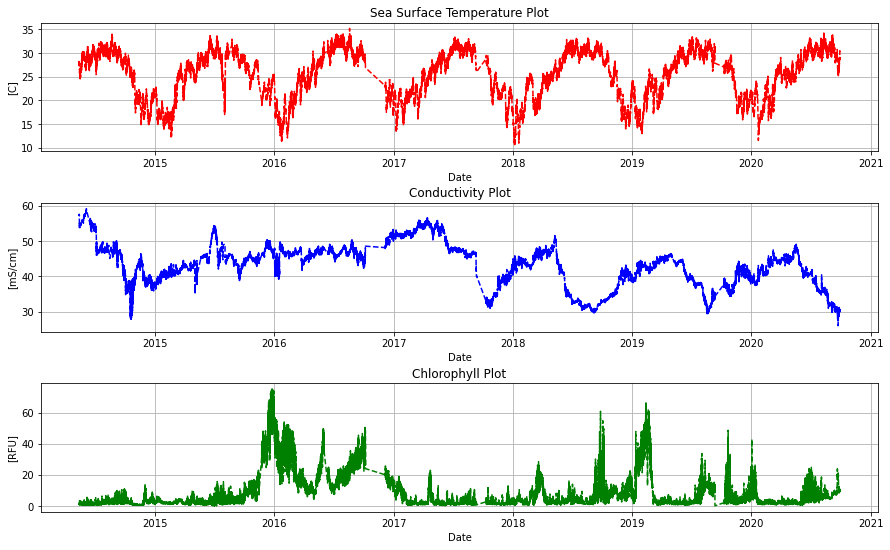

In [138]:
# Main Plot
plt.figure(figsize=(15,9))
plt.subplots_adjust(hspace = .4)

heads = wq_data.columns  # lazy list of cloumn names

# SST
plt.subplot(311)
plt.plot(wq_data[heads[0]], 'r--')
plt.title("Sea Surface Temperature Plot")
plt.xlabel('Date')
plt.ylabel('[C]')
plt.grid()

# Conductivity
plt.subplot(312)
plt.plot(wq_data[heads[1]], 'b--')
plt.title("Conductivity Plot")
plt.xlabel('Date')
plt.ylabel('[mS/cm]')
plt.grid()

# Chlorophyll
plt.subplot(313)
plt.plot(wq_data[heads[2]], 'g--')
plt.title("Chlorophyll Plot")
plt.xlabel('Date')
plt.ylabel('[RFU]')
plt.grid()

In [133]:
# Advanced Plotting
# SST
wq_data.hvplot.line(x='Date/Time', y=heads[0], xlabel='Date & Time', ylabel='SST [C]', title='Sea Surface Temperature')

:Curve   [Date/Time]   (Water Temp (°C))

In [132]:
# Conductivity
wq_data.hvplot.line(x='Date/Time', y=heads[1], xlabel='Date & Time', ylabel='Sp Con [mS/cm]', title='Conductivity')

:Curve   [Date/Time]   (Conductivity (mS/cm))

In [134]:
# Chlorophyll
wq_data.hvplot.line(x='Date/Time', y=heads[2], xlabel='Date & Time', ylabel='Chl [RFU]', title='Chlorophyll')

:Curve   [Date/Time]   (Rel. Chlorophyl (RFU))